In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
from descartes import PolygonPatch
from shapely.geometry import LineString
from shapely.geometry import Point
from shapely.geometry import Polygon
import numpy as np
import pandas as pd
%matplotlib inline
import folium
import matplotlib.pyplot as plt
import mplleaflet
from folium.plugins import HeatMap

In [2]:
#filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"

In [10]:
cbd = pd.read_csv("C:/Users/HP/Desktop/OSMnx Work/CBD.csv")
cbd

,city,CBD,cordinates,distance
0,Delhi,Connaught Place,"(28.632050, 77.219941)",2000.0
1,Delhi,Nehru Place,"(28.549433, 77.252047)",3000.0
2,Bangalore,Koramangala,"(12.932762, 77.624139)",3000.0
3,Bangalore,Shivajinagar,"(12.985525, 77.604328)",2000.0
4,Bangalore,Bangalore CBD,"(12.973151, 77.613721)",2000.0
5,Bangalore,Indiranagar,"(12.975914, 77.640586)",2000.0
6,Bangalore,Electronic City,"(12.835988, 77.673752)",5000.0
7,Mumbai,Ballard Estate,"(18.936572, 72.836912)",1000.0
8,Mumbai,Nariman Point,"(18.925418, 72.823906)",1000.0
9,Mumbai,Cuffe Parade,"(18.914495, 72.820083)",1000.0


## 1. For circuity

In [7]:
%%capture --no-stdout

data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    
    # convert MultiDiGraph to an undirected MultiGraph
    M = ox.get_undirected(G)
    circ = ox.stats.circuity_avg(M)
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Circuity':circ})
    print('Circuity for', cbd['CBD'][i], '('+cbd['city'][i]+') is',circ)

Circuity = pd.DataFrame(data)
Circuity.to_csv("C:/Users/HP/Desktop/OSMnx Work/All_ircuity.csv")

Circuity for Connaught Place (Delhi) is 1.0340995787058898
Circuity for Nehru Place (Delhi) is 1.0417502300606738
Circuity for Koramangala (Bangalore) is 1.0313394851382454
Circuity for Shivajinagar (Bangalore) is 1.0325991131643137
Circuity for Bangalore CBD (Bangalore) is 1.029949808071629
Circuity for Indiranagar (Bangalore) is 1.0310581461880877
Circuity for Electronic City (Bangalore) is 1.0700591841077365
Circuity for Ballard Estate (Mumbai) is 1.0227176973415677
Circuity for Nariman Point (Mumbai) is 1.0459665816225898
Circuity for Cuffe Parade (Mumbai) is 1.0271727127624886
Circuity for Bandra Kurla Complex (Mumbai) is 1.0493906408366103
Circuity for CBD Belapur (Mumbai) is 1.0790780455249354
Circuity for Anna Salai (Chennai) is 1.0269293646289865
Circuity for T Nagar (Chennai) is 1.0246049266514747
Circuity for Parry's Corner, George Town (Chennai) is 1.0097704686346616
Circuity for Nungambakkam (Chennai) is 1.028386574964292
Circuity for Gujarat International Finance Tec-City

## 2. No. of Nodes and Edges for walk & drive network

In [59]:
%%capture --no-stdout

for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    city = 
    place = 
    
    # Importing data from OSM using centre point
    Gw = ox.graph_from_point(location, dist = dist, network_type = 'walk')
    Gd = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    
    print('\n',i+1,'.', cbd['city'][i],',' , cbd['CBD'][i], ':', '\nFor walk, Nodes=',len(Gw.nodes), '&', 'Edges=', len(Gw.edges),
         '\nFor drive, Nodes=',len(Gd.nodes), '&', 'Edges=', len(Gd.edges))
    


 1 . Delhi , Connaught Place : 
For walk, Nodes= 2733 & Edges= 7620 
For drive, Nodes= 1604 & Edges= 3790

 2 . Delhi , Nehru Place : 
For walk, Nodes= 6312 & Edges= 18226 
For drive, Nodes= 5076 & Edges= 13435

 3 . Bangalore  , Koramangala : 
For walk, Nodes= 7918 & Edges= 22296 
For drive, Nodes= 6883 & Edges= 18404

 4 . Bangalore  , Shivajinagar : 
For walk, Nodes= 2925 & Edges= 8366 
For drive, Nodes= 1931 & Edges= 4724

 5 . Bangalore  , Bangalore CBD : 
For walk, Nodes= 2900 & Edges= 8252 
For drive, Nodes= 2229 & Edges= 5608

 6 . Bangalore  , Indiranagar : 
For walk, Nodes= 3368 & Edges= 9472 
For drive, Nodes= 2676 & Edges= 6985

 7 . Bangalore  , Electronic City : 
For walk, Nodes= 7619 & Edges= 18668 
For drive, Nodes= 6502 & Edges= 15713

 8 . Mumbai , Ballard Estate : 
For walk, Nodes= 635 & Edges= 1918 
For drive, Nodes= 440 & Edges= 934

 9 . Mumbai , Nariman Point : 
For walk, Nodes= 429 & Edges= 1300 
For drive, Nodes= 340 & Edges= 740

 10 . Mumbai , Cuffe Parade :

## 3. Edge attributes

In [ ]:
%%capture --no-stdout

for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    city = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{city}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # impute speed on all edges missing data
    G = ox.add_edge_speeds(G)
    # calculate travel time (seconds) for all edges
    G = ox.add_edge_travel_times(G)
    
    # extracting nodes and edges
    nodes, edges = ox.graph_to_gdfs(G)
    
    ### EDGE ATTRIBUTES
    # 1) Highways
    highway = edges['highway'].value_counts()
    #Converting geodataframe (geopanda) to panda
    highway = pd.DataFrame(highway)
    # saving panda dataframe to csv format in local
    highway.to_csv(f"{filepath}/Edge_Attributes/{place}_highway.csv")
    
    # 2) Oneway
    oneway = edges['oneway'].value_counts()
    oneway = pd.DataFrame(oneway)
    oneway.to_csv(f"{filepath}/Edge_Attributes/{place}_oneway.csv")
    
    # 3) Speed KMPH
    speed_kph = edges['speed_kph'].value_counts()
    speed_kph = pd.DataFrame(speed_kph)
    speed_kph.to_csv(f"{filepath}/Edge_Attributes/{place}_speed_kph.csv")
    
    # 4) Lanes
    lanes = edges['lanes'].value_counts()
    lanes = pd.DataFrame(lanes)
    lanes.to_csv(f"{filepath}/Edge_Attributes/{place}_lanes.csv")
    
    # 5) Junction
    junction = edges['junction'].value_counts()
    junction = pd.DataFrame(junction)
    junction.to_csv(f"{filepath}/Edge_Attributes/{place}_junction.csv")
    
    # 6) Access
    access = edges['access'].value_counts()
    access = pd.DataFrame(access)
    access.to_csv(f"{filepath}/Edge_Attributes/{place}_access.csv")
    
    # 7) maximum Speed
    maxspeed = edges['maxspeed'].value_counts()
    maxspeed = pd.DataFrame(maxspeed)
    maxspeed.to_csv(f"{filepath}/Edge_Attributes/{place}_maxspeed.csv")
    
    # 8) Bridges
    bridge = edges['bridge'].value_counts()
    bridge = pd.DataFrame(bridge)
    bridge.to_csv(f"{filepath}/Edge_Attributes/{place}_bridge.csv")
    
    print(place, ", edge attributes saved.")

## 4. Centrality

### 4.1 Betweenness Centrality

In [ ]:
%%capture --no-stdout

data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    D = ox.get_digraph(G)
    
    # 1) Betweenness Centrality
    centrality = nx.betweenness_centrality(D, weight = 'length')
    max_node, max_bc = max(centrality.items(), key=lambda x: x[1])
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Node':max_node, 'BC':max_bc})
    
    print('\n',i+1,'.',cbd['CBD'][i],': Node =',max_node, ', BC =',max_bc)
    
betn_centrality = pd.DataFrame(data)
betn_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/betn_centrality.csv")

#### 4.1.1 BC with Saving Maps

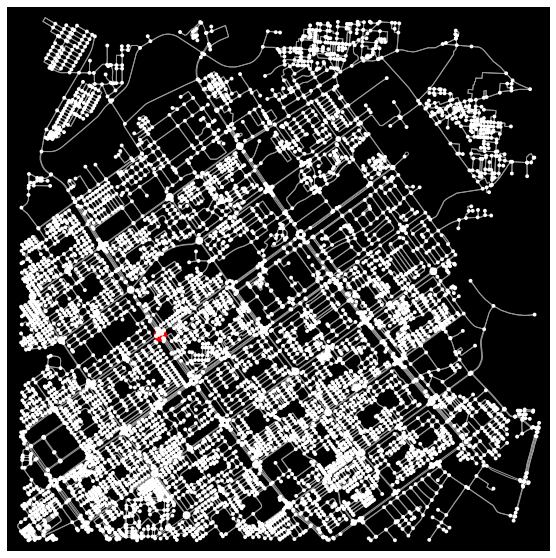

Sector 17 : 
Node 1428391227 has highest betweenness Centrality,
 9.11 % of shortest path pass through this node.


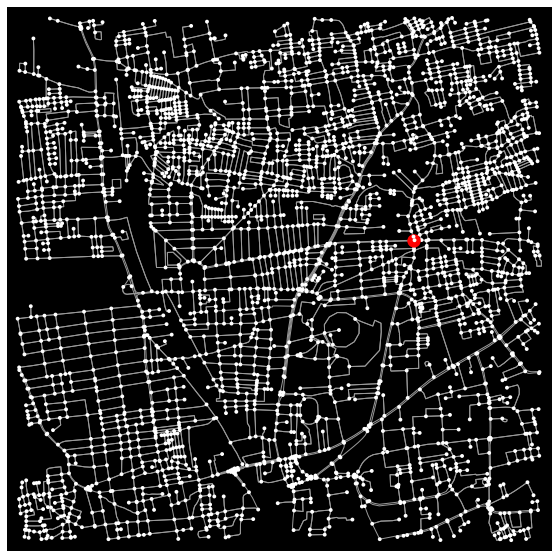

Gandhipuram : 
Node 5563630831 has highest betweenness Centrality,
 12.11 % of shortest path pass through this node.


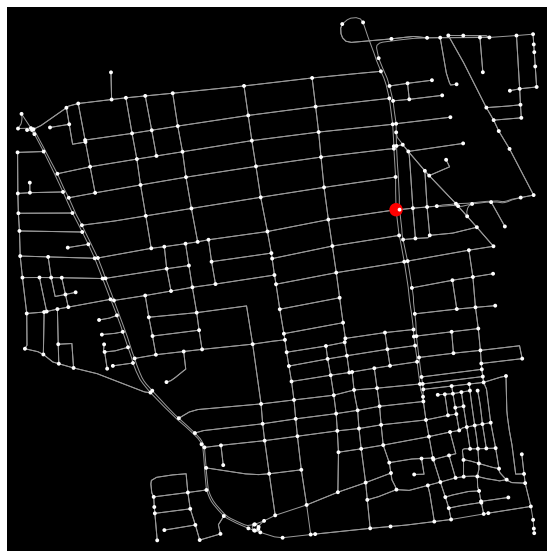

RS Puram : 
Node 330041139 has highest betweenness Centrality,
 17.67 % of shortest path pass through this node.


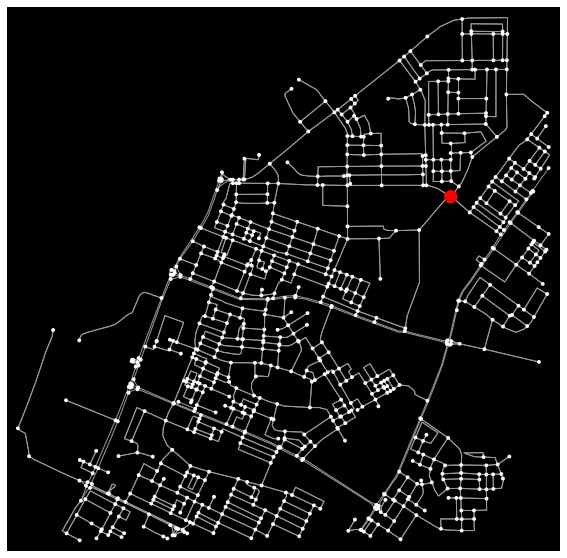

City Centre : 
Node 4014421671 has highest betweenness Centrality,
 15.28 % of shortest path pass through this node.


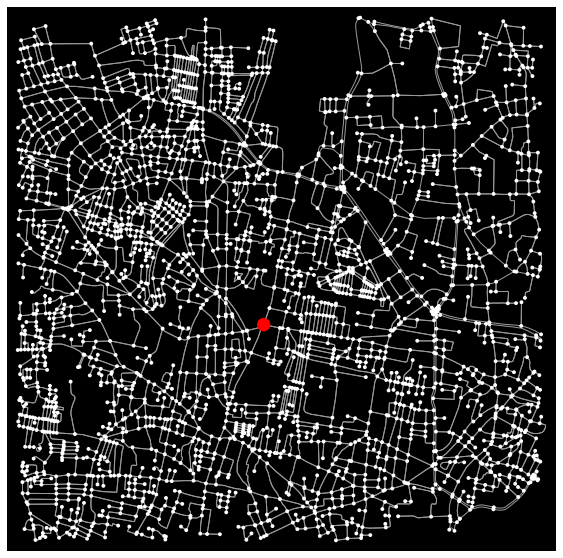

Nampally : 
Node 308527238 has highest betweenness Centrality,
 17.55 % of shortest path pass through this node.


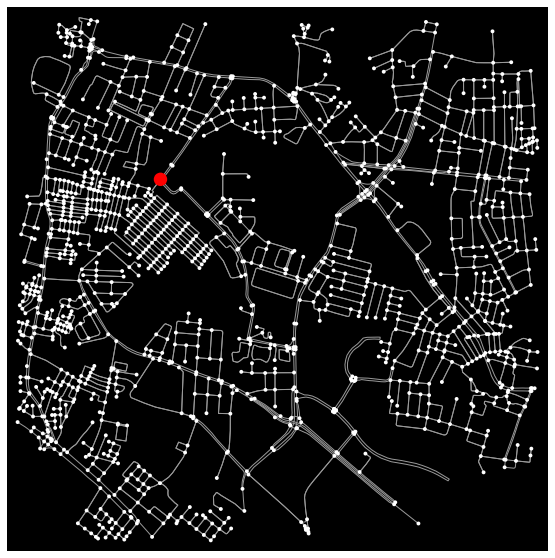

HITEC City : 
Node 1042219307 has highest betweenness Centrality,
 16.92 % of shortest path pass through this node.


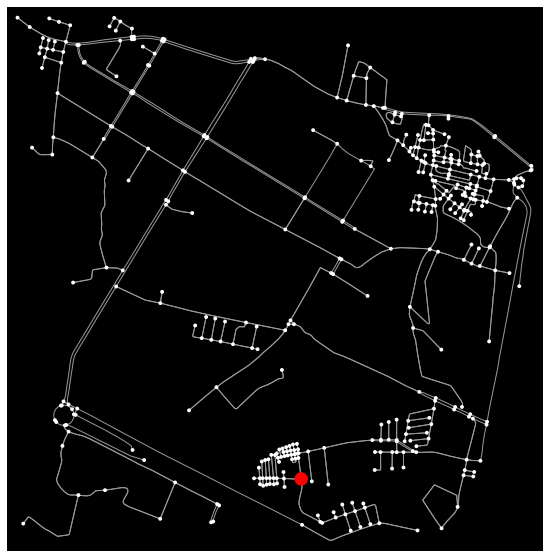

Nanakramguda : 
Node 7694801932 has highest betweenness Centrality,
 24.79 % of shortest path pass through this node.


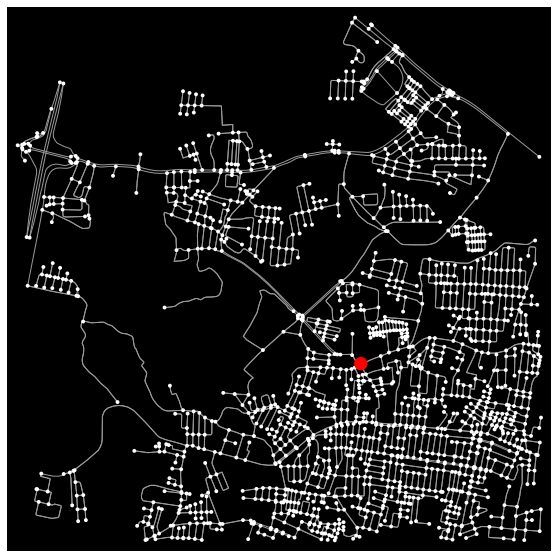

Manikonda : 
Node 2803507783 has highest betweenness Centrality,
 31.26 % of shortest path pass through this node.


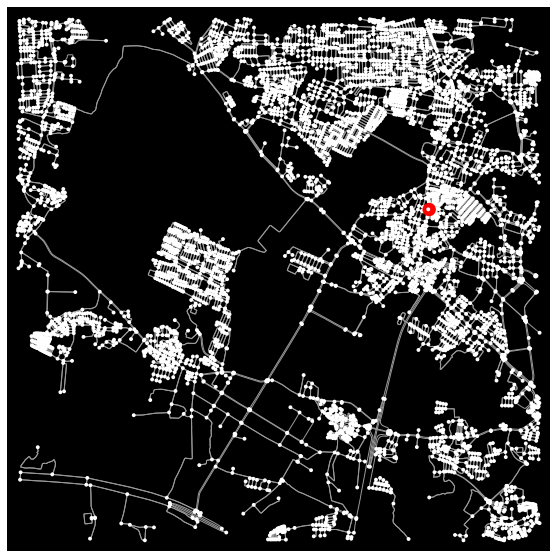

Gachibowli : 
Node 5430775786 has highest betweenness Centrality,
 19.78 % of shortest path pass through this node.


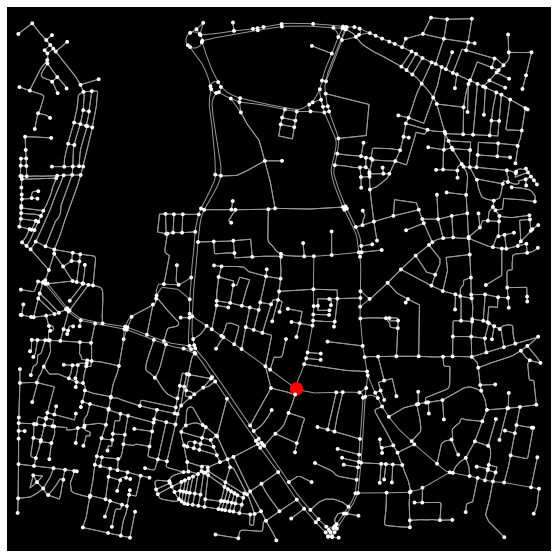

Abids : 
Node 1819983547 has highest betweenness Centrality,
 21.46 % of shortest path pass through this node.


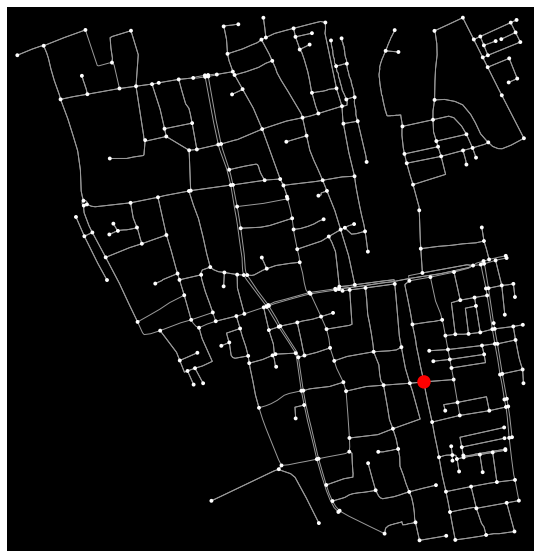

MG road : 
Node 6880980333 has highest betweenness Centrality,
 28.47 % of shortest path pass through this node.


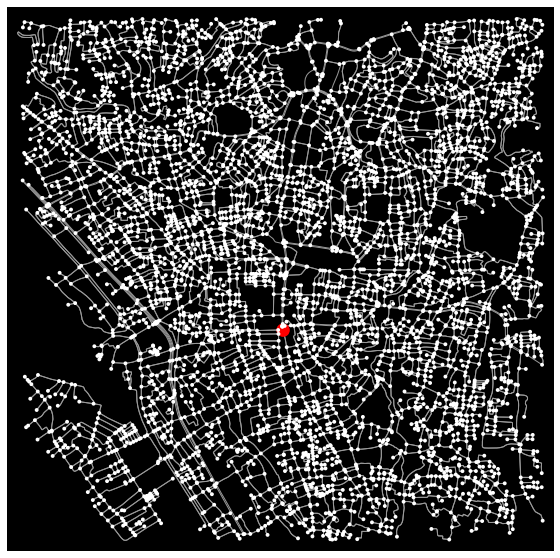

East Fort : 
Node 457119147 has highest betweenness Centrality,
 12.3 % of shortest path pass through this node.


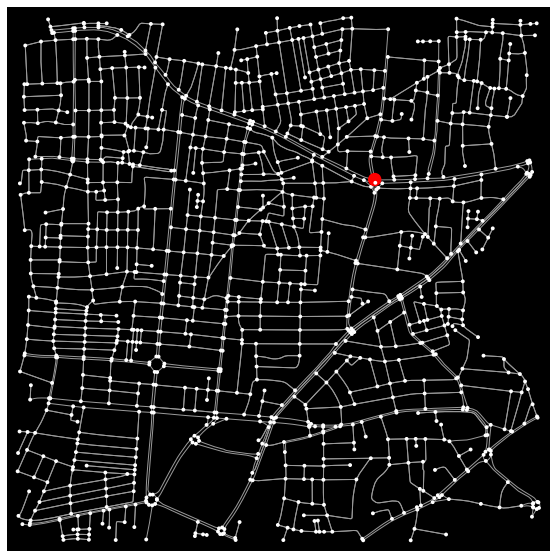

Dwaraka Nagar : 
Node 8208276930 has highest betweenness Centrality,
 17.71 % of shortest path pass through this node.


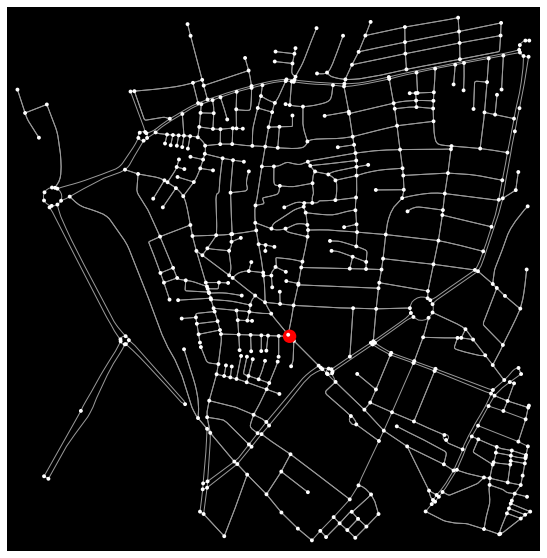

Daba Gardens : 
Node 3762286437 has highest betweenness Centrality,
 19.5 % of shortest path pass through this node.


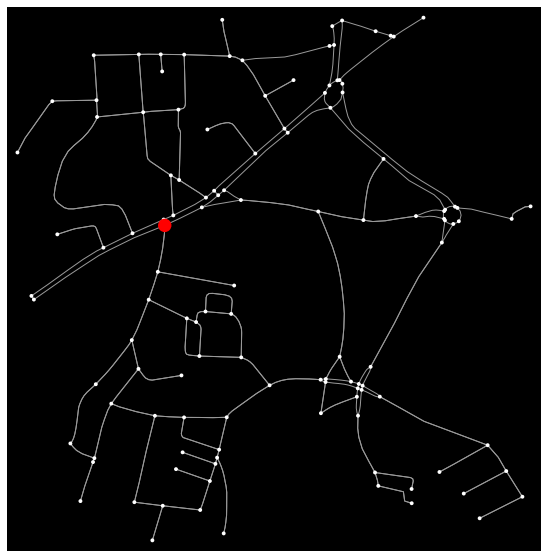

Siripuram : 
Node 5956687228 has highest betweenness Centrality,
 33.69 % of shortest path pass through this node.


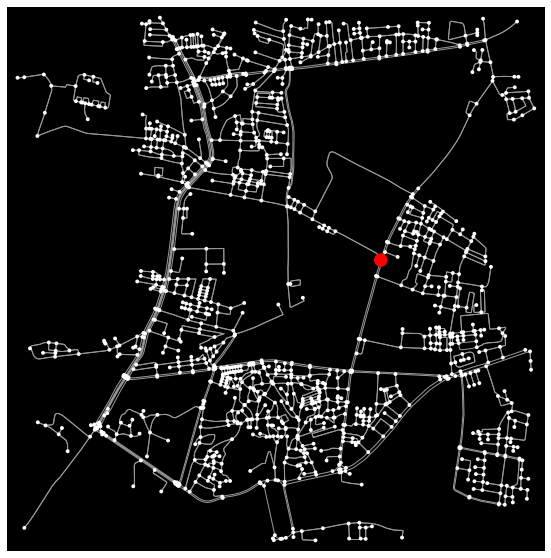

Yerwada Nagar : 
Node 2514805759 has highest betweenness Centrality,
 26.74 % of shortest path pass through this node.


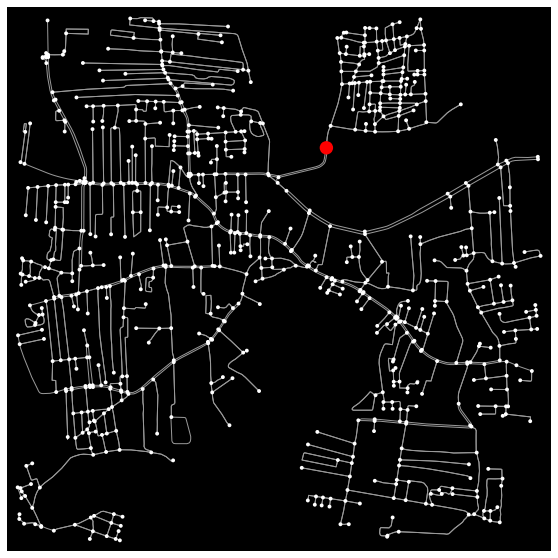

Baner gaon : 
Node 2562920612 has highest betweenness Centrality,
 22.46 % of shortest path pass through this node.


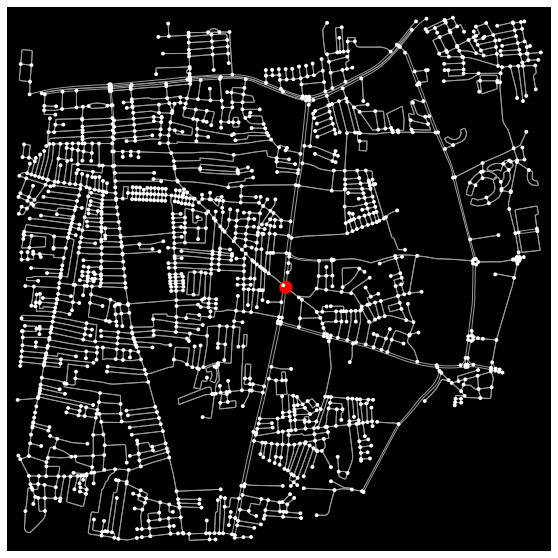

Nagar Road : 
Node 1225175046 has highest betweenness Centrality,
 21.34 % of shortest path pass through this node.


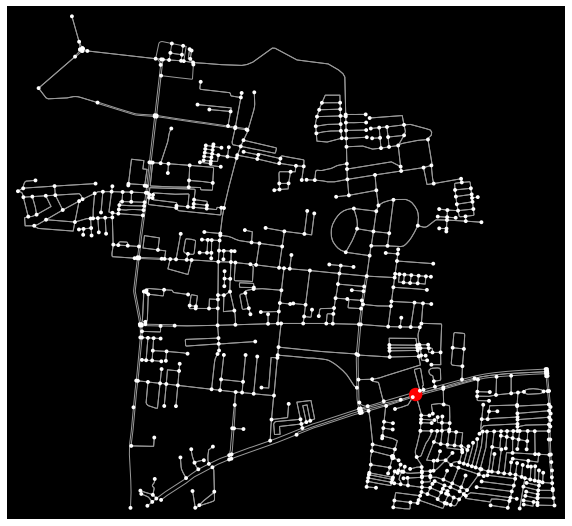

Viman nagar : 
Node 4671943961 has highest betweenness Centrality,
 39.05 % of shortest path pass through this node.


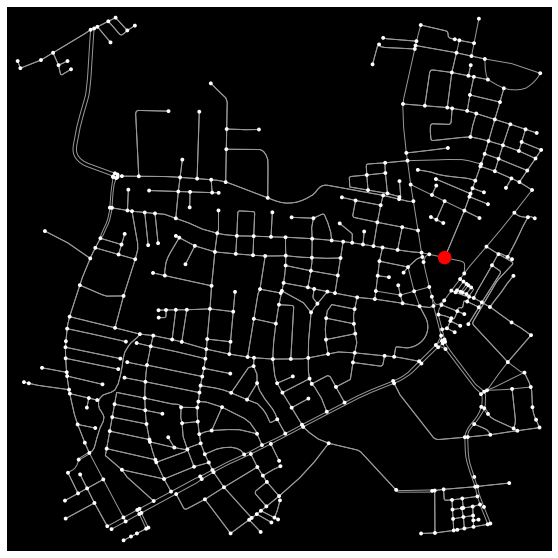

Deccan Gymkhana : 
Node 2192111582 has highest betweenness Centrality,
 20.64 % of shortest path pass through this node.


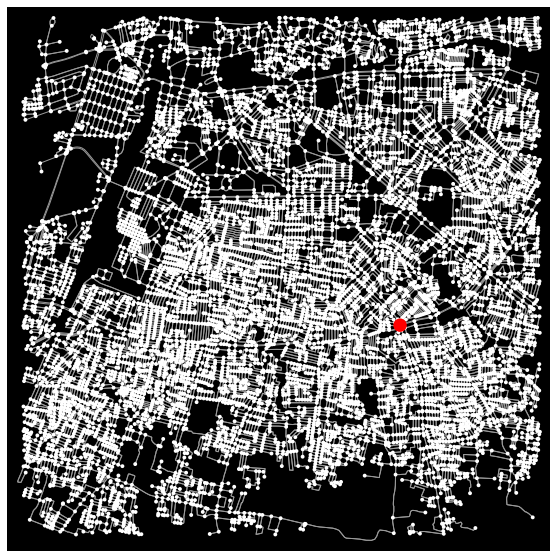

Bardi : 
Node 4273126445 has highest betweenness Centrality,
 11.8 % of shortest path pass through this node.


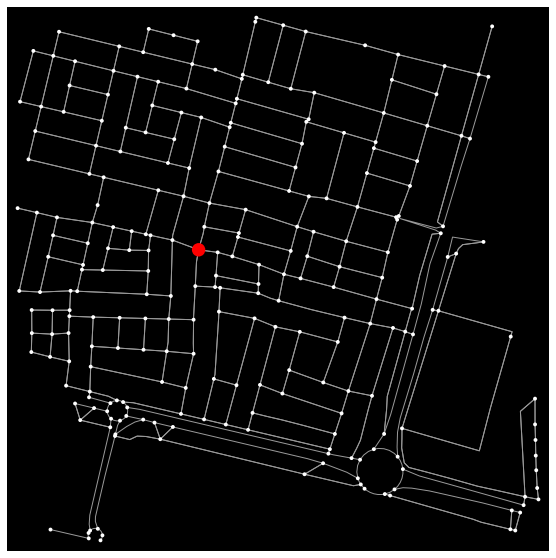

Vijay Nagar : 
Node 2020698964 has highest betweenness Centrality,
 19.42 % of shortest path pass through this node.


In [6]:
data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    region = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    D = ox.get_digraph(G)
    
    # 1) Betweenness Centrality
    centrality = nx.betweenness_centrality(D, weight = 'length')
    max_node, max_bc = max(centrality.items(), key=lambda x: x[1])
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Node':max_node, 'BC':max_bc})
    
   
    # find out node and plot on graph
    node_color = ['red' if node == max_node else 'white' for node in G.nodes]
    node_size = [180 if node == max_node else 15 for node in G.nodes]
    fig, ax = ox.plot_graph(G,figsize = (10,10), node_color = node_color, node_size = node_size,save=True,
                            filepath=f"{filepath}/BC_{place}.jpg", bgcolor = 'k')
    print(f"{place} :",'\nNode', max_node, "has highest betweenness Centrality,\n",
          round(max_bc*100,2), '% of shortest path pass through this node.')
    
betn_centrality = pd.DataFrame(data)
betn_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/betn_centrality.csv")

#### 4.1.2 BC Node map

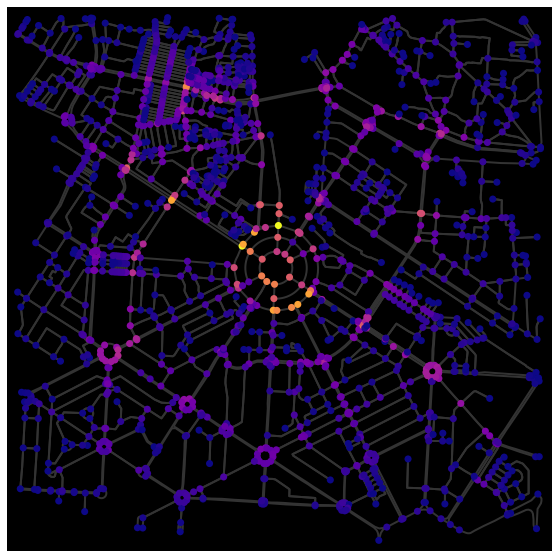

Delhi : Connaught Place


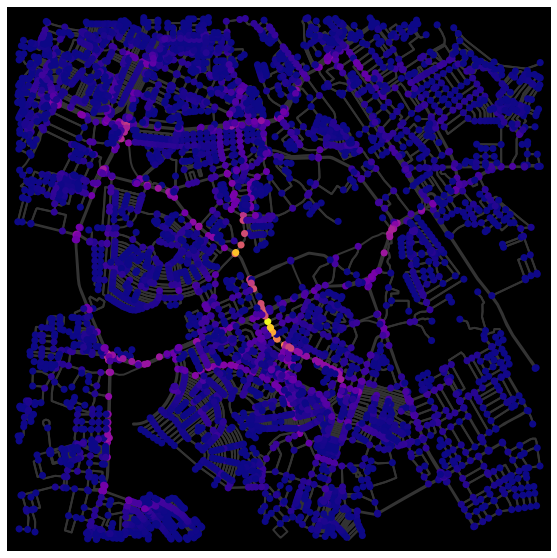

Delhi : Nehru Place


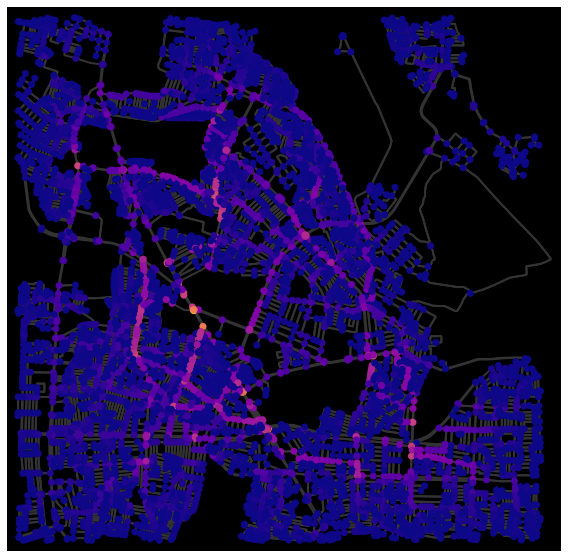

Bangalore : Koramangala


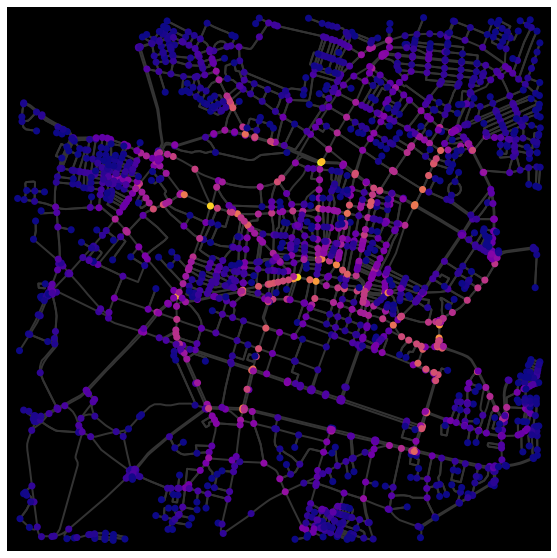

Bangalore : Shivajinagar


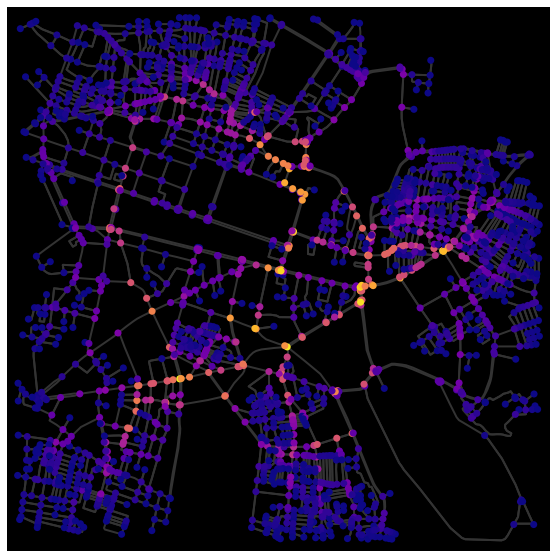

Bangalore : Bangalore CBD


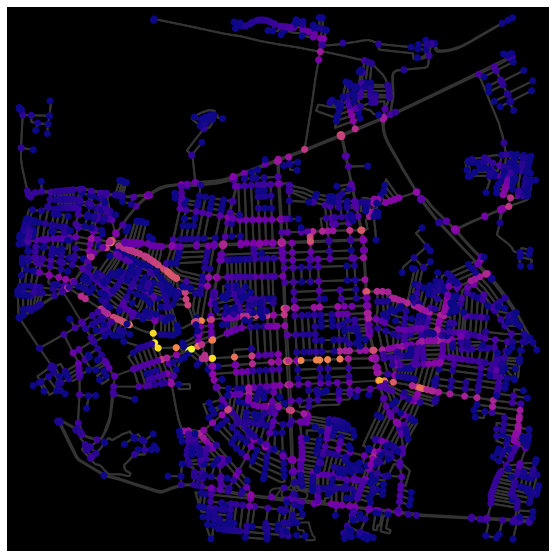

Bangalore : Indiranagar


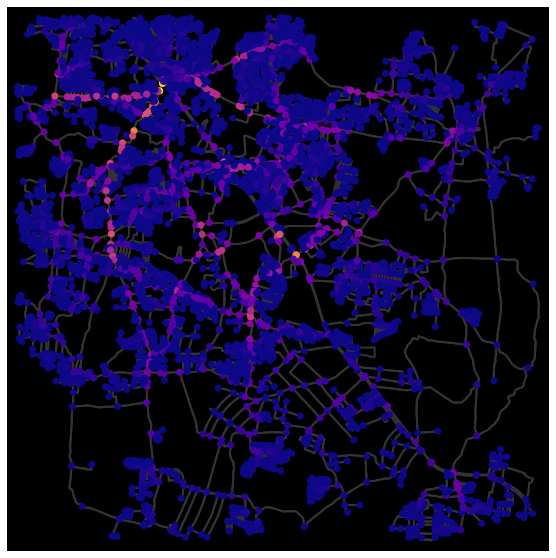

Bangalore : Electronic City


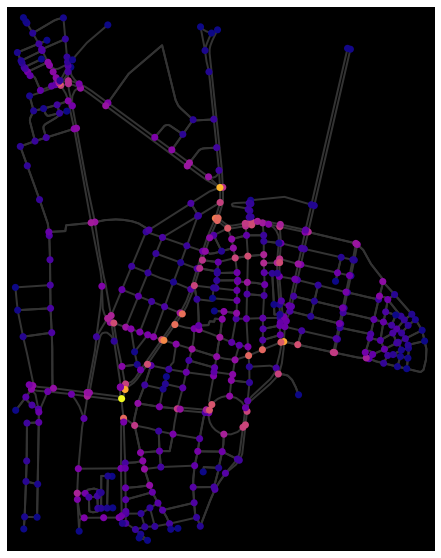

Mumbai : Ballard Estate


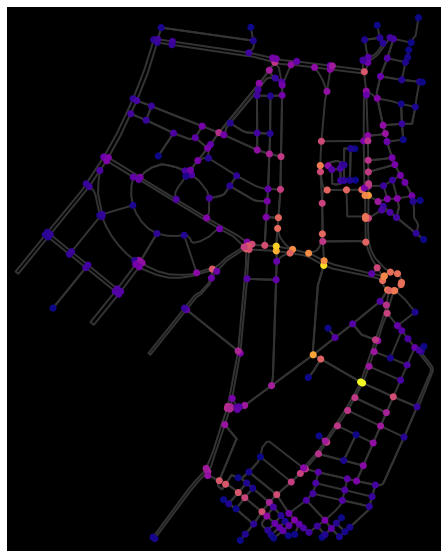

Mumbai : Nariman Point


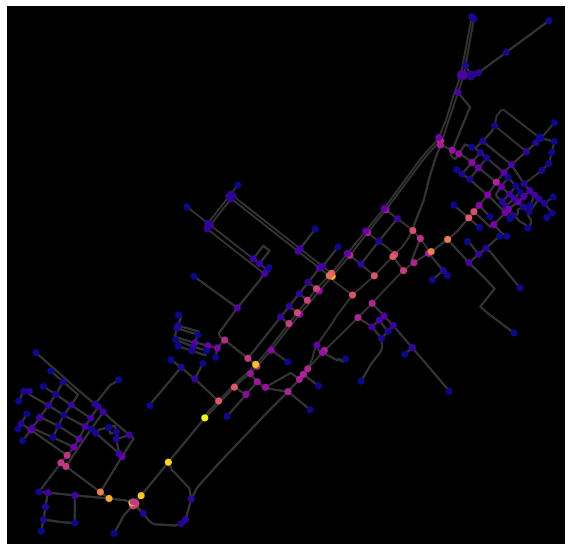

Mumbai : Cuffe Parade


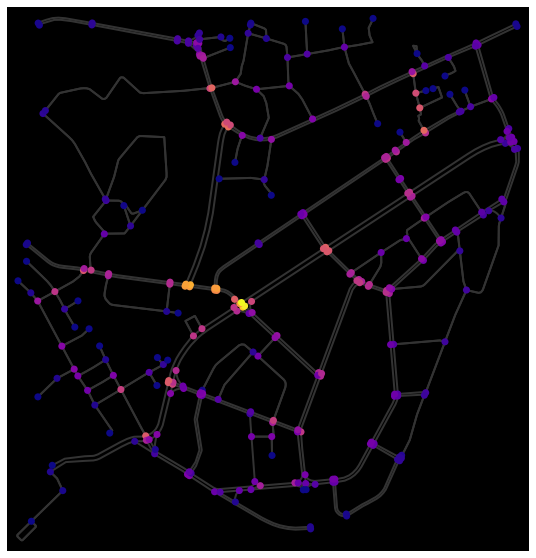

Mumbai : Bandra Kurla Complex


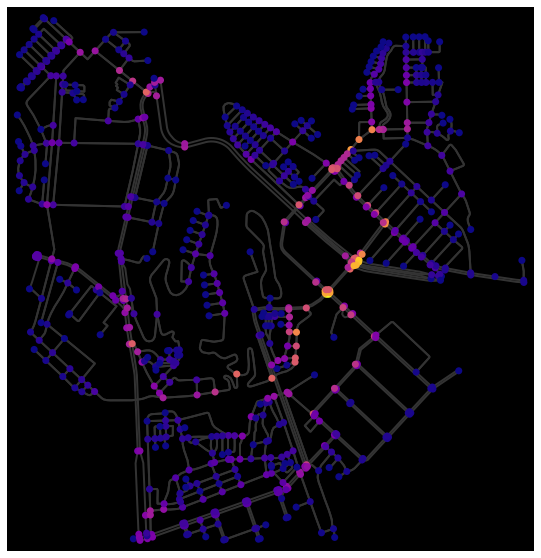

Mumbai : CBD Belapur


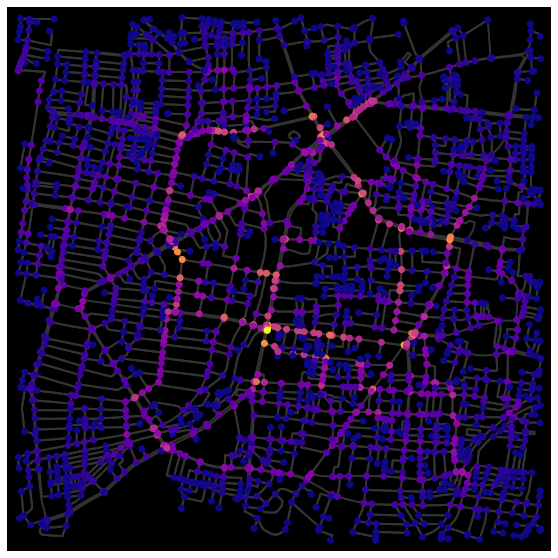

Chennai : Anna Salai


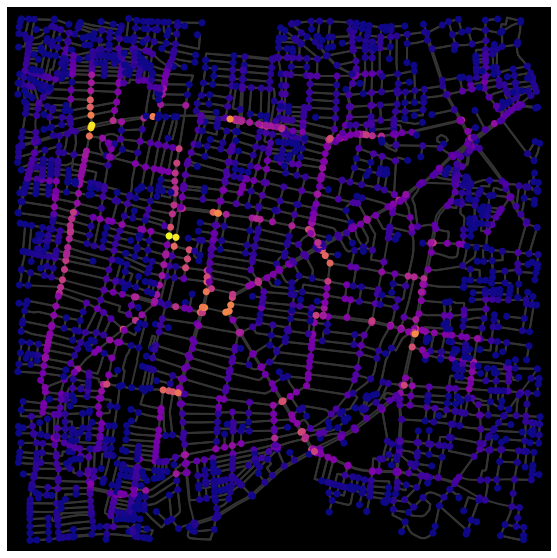

Chennai : T Nagar


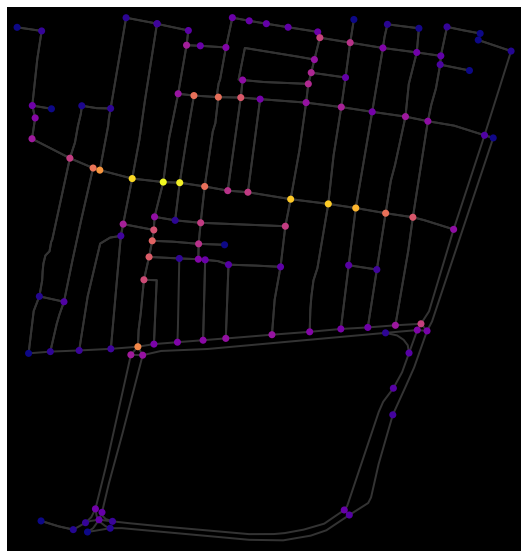

Chennai : Parry's Corner, George Town


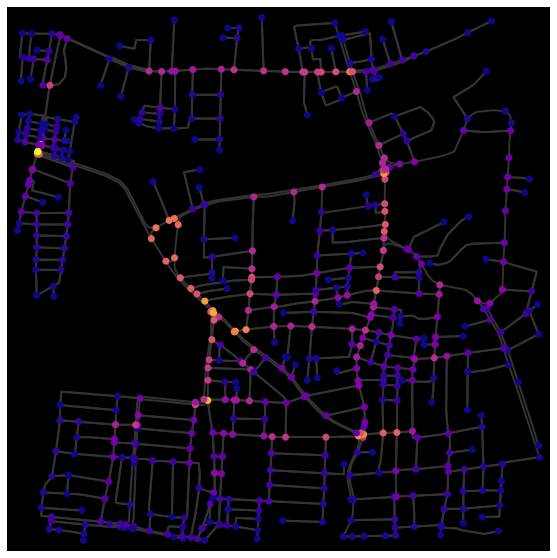

Chennai : Nungambakkam


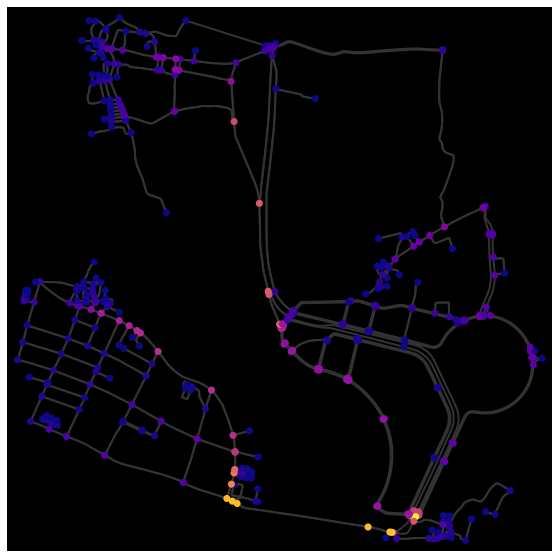

Ahmedabad : Gujarat International Finance Tec-City


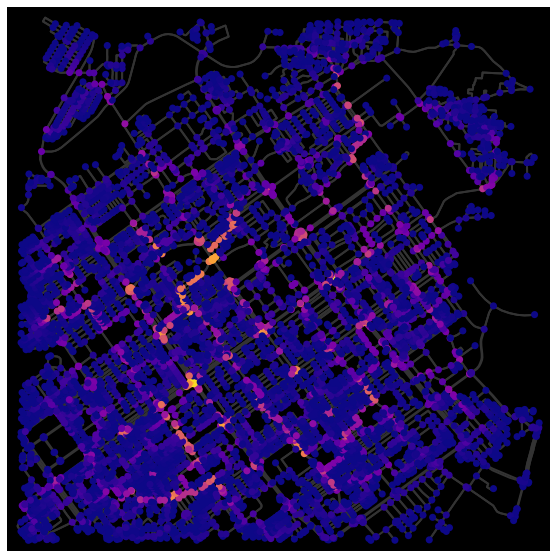

Chandigarh : Sector 17


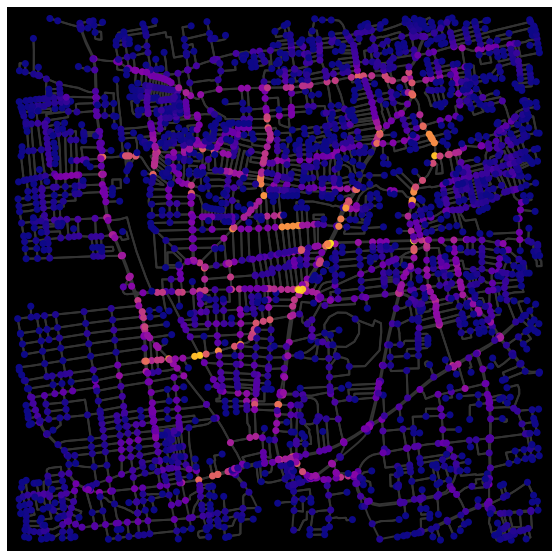

Coimbatore : Gandhipuram


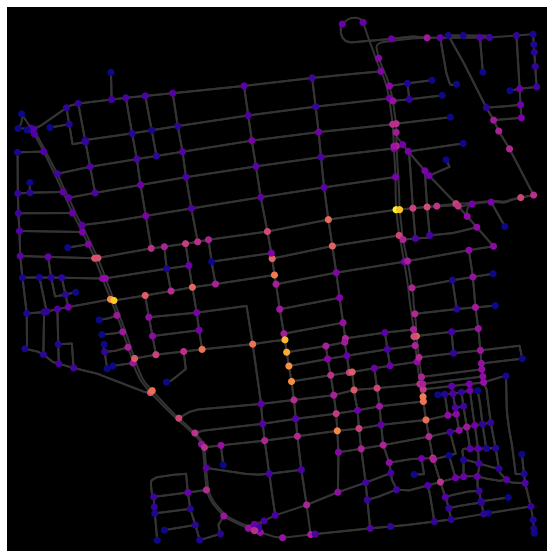

Coimbatore : RS Puram


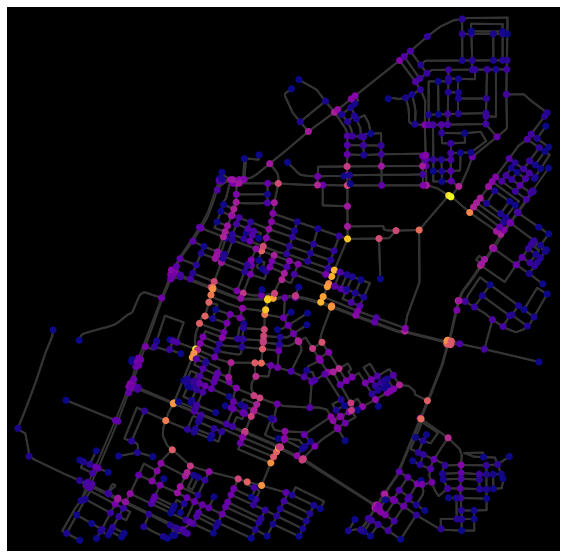

Bokaro Steel city : City Centre


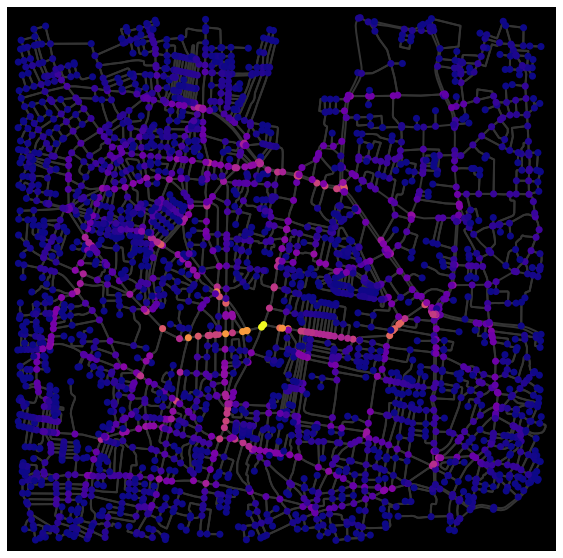

Hyderabad : Nampally


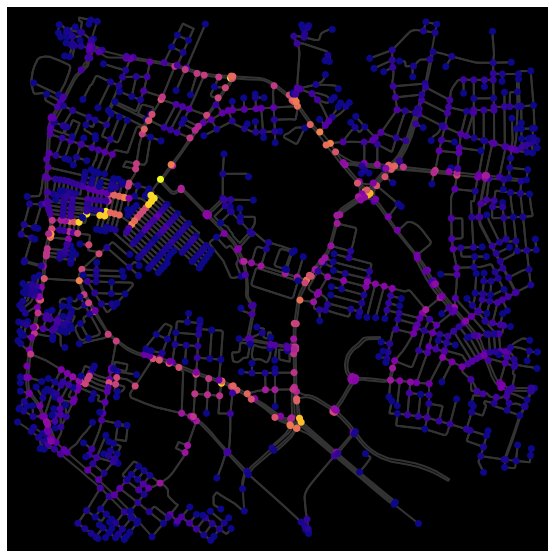

Hyderabad : HITEC City


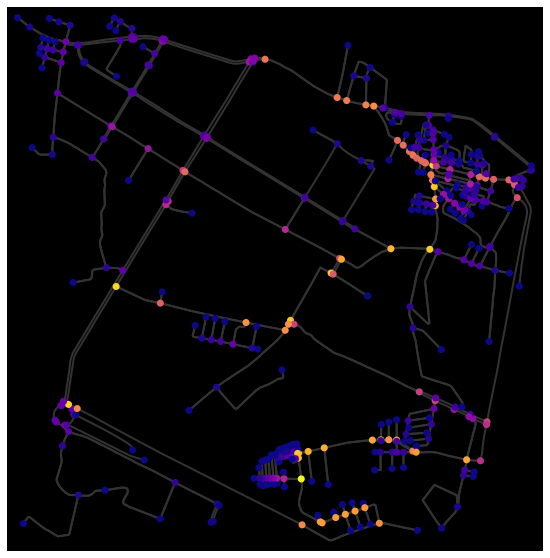

Hyderabad : Nanakramguda


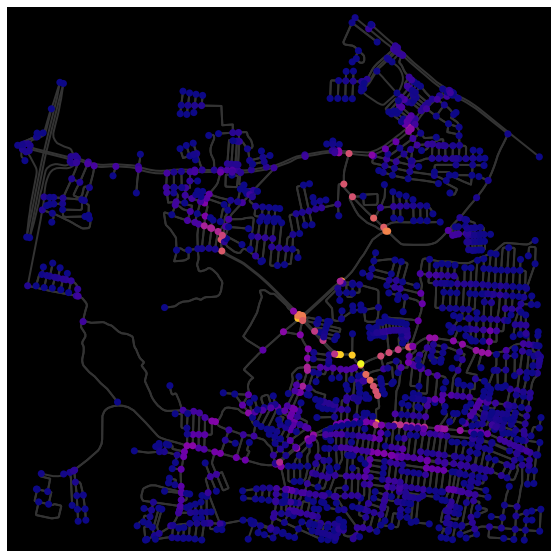

Hyderabad : Manikonda


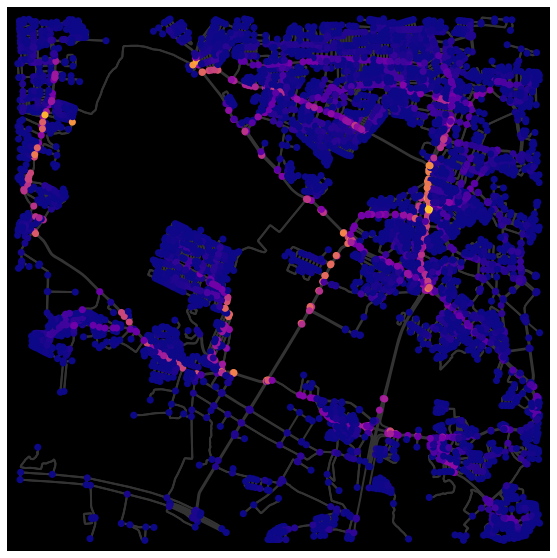

Hyderabad : Gachibowli


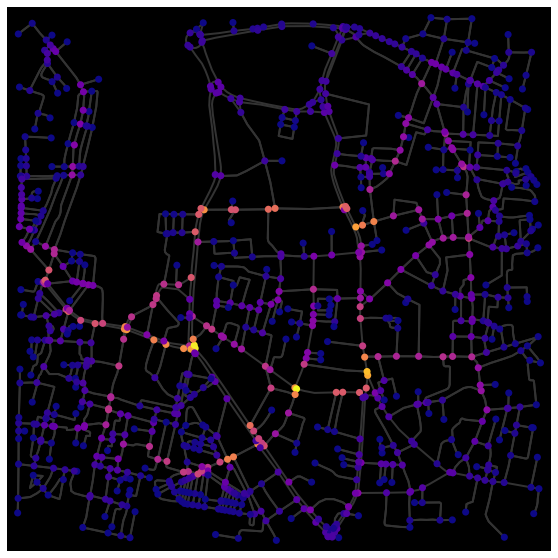

Hyderabad : Abids


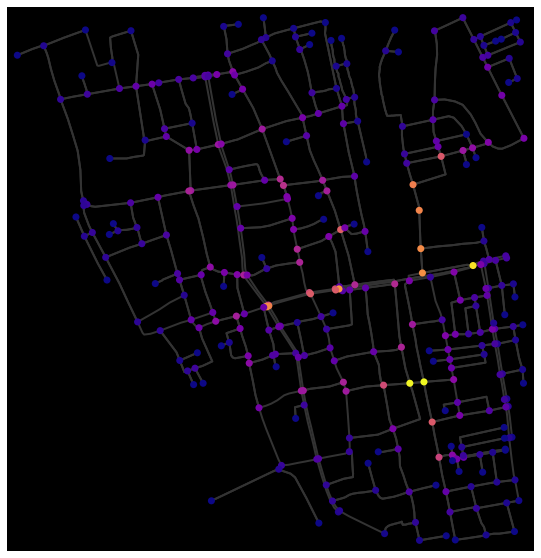

Kochi : MG road


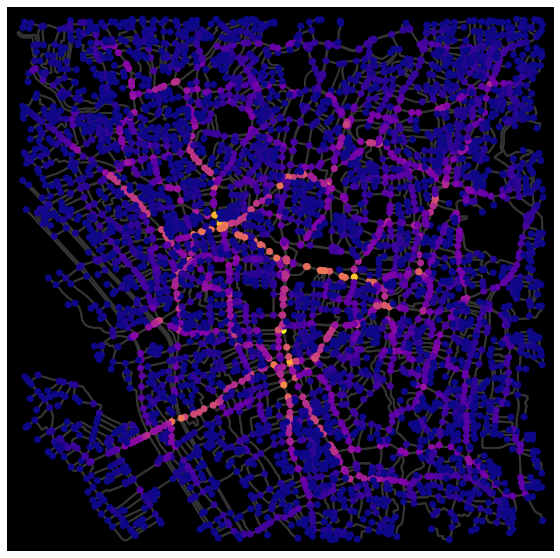

Trivandrum : East Fort


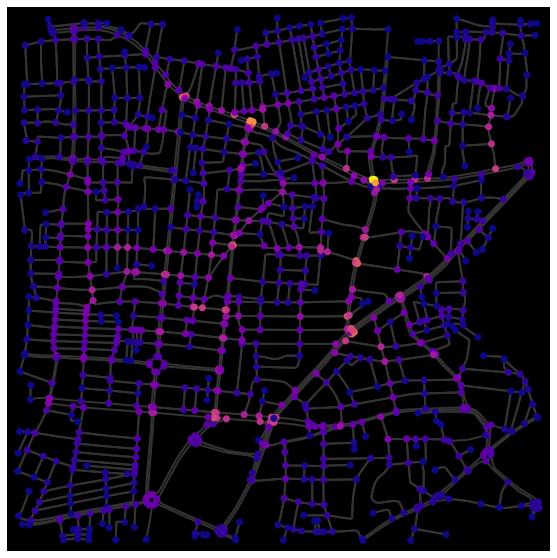

Visakhapattanam : Dwaraka Nagar


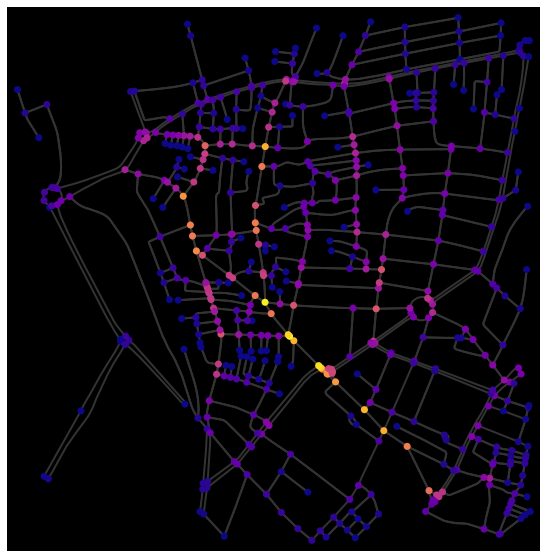

Visakhapattanam : Daba Gardens


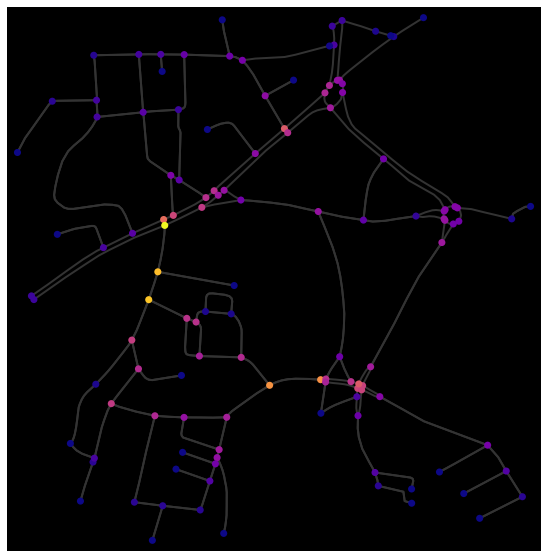

Visakhapattanam : Siripuram


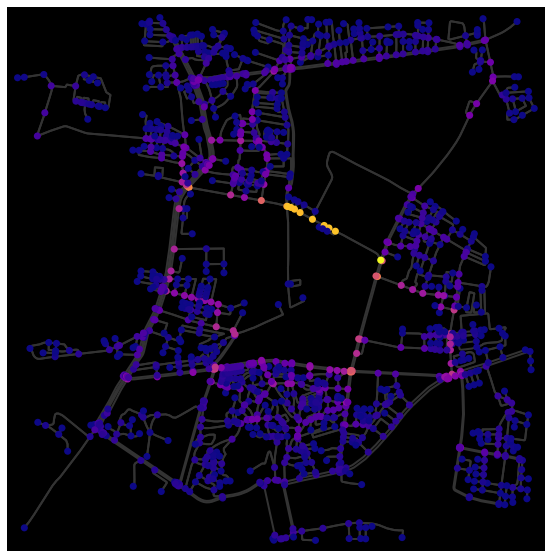

Pune : Yerwada Nagar


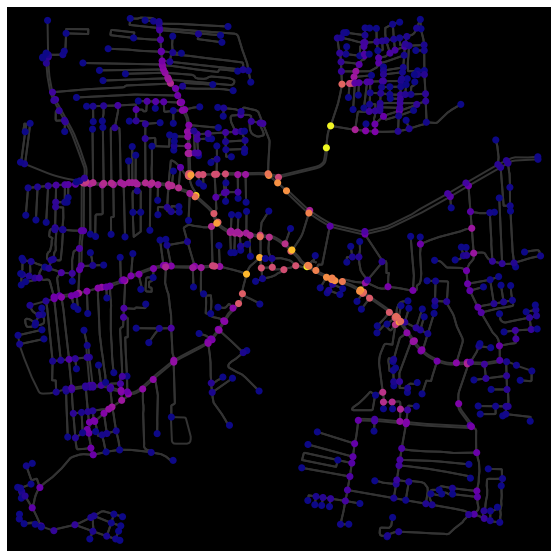

Pune : Baner gaon


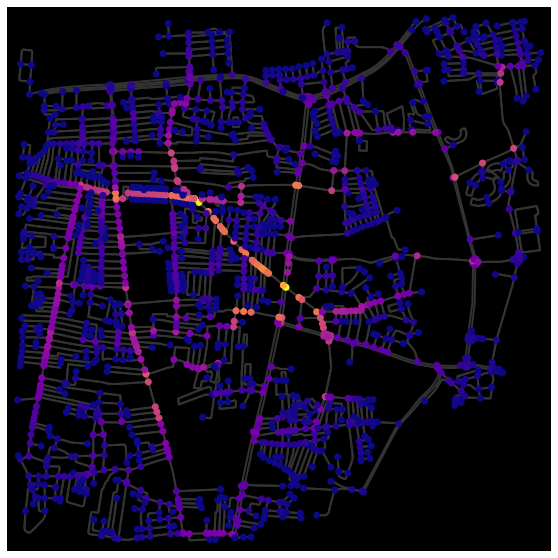

Pune : Nagar Road


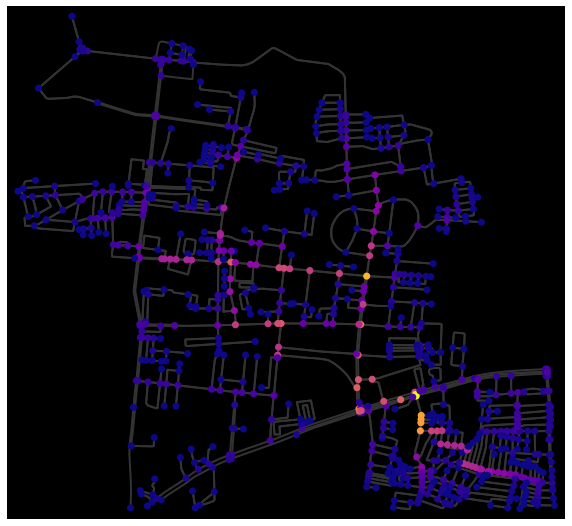

Pune : Viman nagar


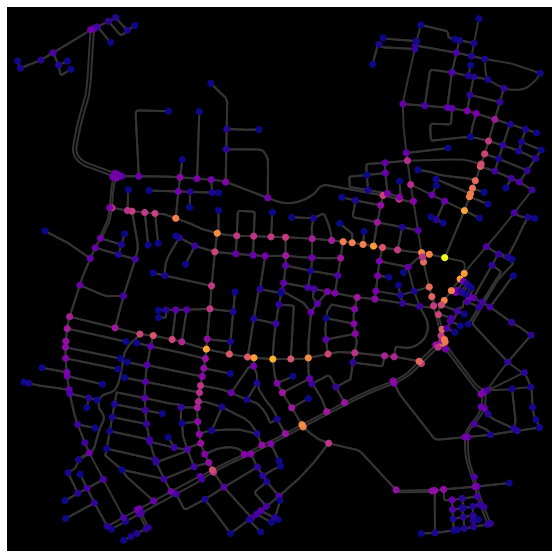

Pune : Deccan Gymkhana


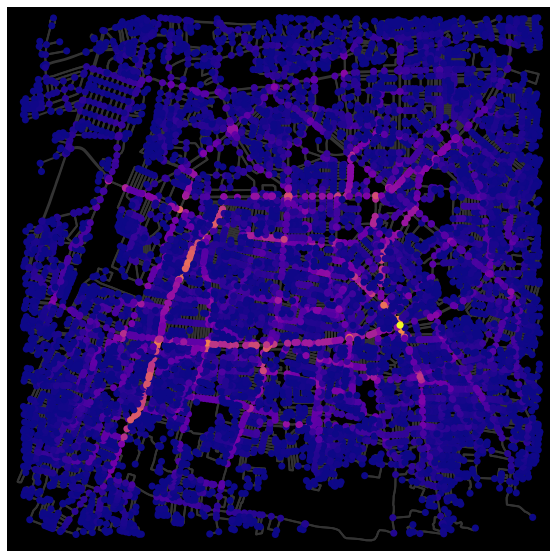

Nagpur : Bardi


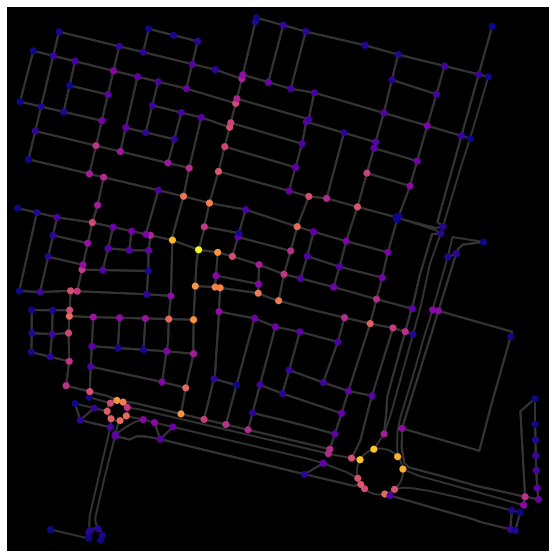

Indore : Vijay Nagar


In [17]:
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    region = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    D = ox.get_digraph(G)
    
    # 1) Betweenness Centrality
    # calculate node betweenness centrality, weighted by length
    bc = nx.betweenness_centrality(D, weight="length", normalized=True)
    nx.set_node_attributes(G, values=bc, name="bc")

    # plot the graph, coloring nodes by betweenness centrality
    nc = ox.plot.get_node_colors_by_attr(G, "bc", cmap="plasma")
    fig, ax = ox.plot_graph(G,figsize = (10,10), bgcolor="black", node_color=nc, node_size=50, edge_linewidth=2, edge_color="#333333",
                            save=True, filepath=f"{filepath}/BC_plot_{place}.jpg")
    print(region,':',place)

#### 4.1.3 BC heat map (with edge centrality)

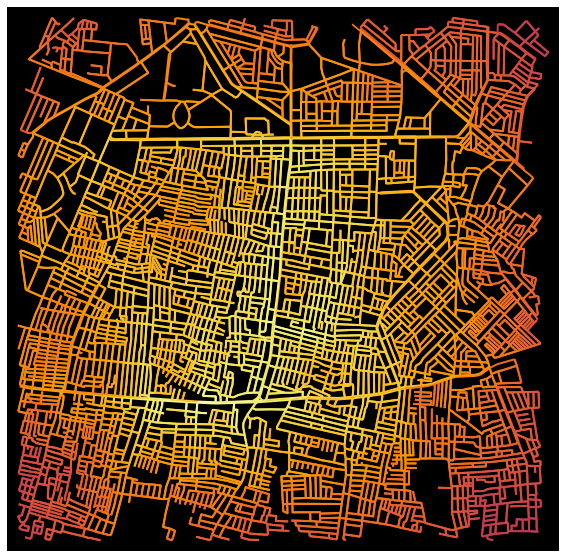

Nagpur : Bardi


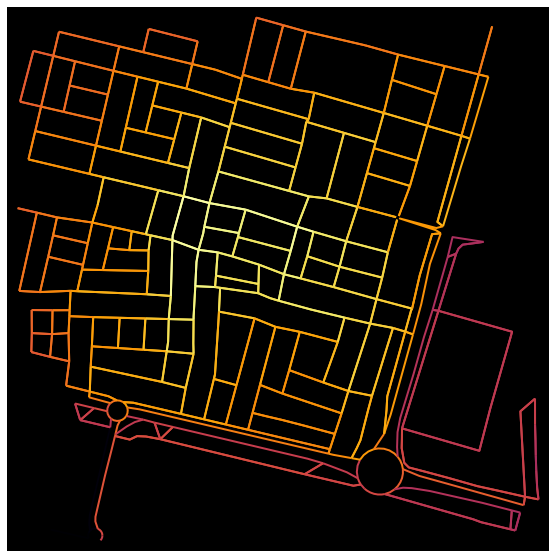

Indore : Vijay Nagar


In [9]:
import matplotlib.colors as colors
import matplotlib.cm as cm
from pprint import pprint

for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    region = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    
    # calculating node closeness centrality of the line graph
    edge_centrality = nx.closeness_centrality(nx.line_graph(G))
    # making a list of graph edge centrality values
    ev = [edge_centrality[edge + (0,)] for edge in G.edges()]
    # creating a color scale converted to list of colors for graph edges
    norm = colors.Normalize(vmin=min(ev)*0.8, vmax=max(ev))
    cmap = cm.ScalarMappable(norm=norm, cmap=cm.inferno)
    ec = [cmap.to_rgba(cl) for cl in ev]
    # coloring the edges in the original graph by closeness centrality in line graph
    fig, ax = ox.plot_graph(G, bgcolor='black',figsize = (10,10), node_size=0,edge_color=ec, edge_linewidth=2, edge_alpha=1,
                            save=True, filepath=f"{filepath}/BC_heatMap_{place}.jpg")

    print(region,':',place)

### 4.2 Closeness Centrality

In [ ]:
%%capture --no-stdout

data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    D = ox.get_digraph(G)
    
    # 1) Closeness Centrality
    centrality = nx.closeness_centrality(D)
    max_node, max_bc = max(centrality.items(), key=lambda x: x[1])
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Node':max_node, 'CC':max_bc})
    
    print('\n',i+1,'.',cbd['CBD'][i],': Node =',max_node, ', CC =',max_bc)
    
closeness_centrality = pd.DataFrame(data)
closeness_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/closeness_centrality.csv")

#### 4.2.1 CC with Saving Maps

In [ ]:
data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    region = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    D = ox.get_digraph(G)
    
    # 1) Closeness Centrality
    centrality = nx.closeness_centrality(D)
    max_node, max_bc = max(centrality.items(), key=lambda x: x[1])
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Node':max_node, 'CC':max_bc})
    
   
    # find out node and plot on graph
    node_color = ['red' if node == max_node else 'white' for node in G.nodes]
    node_size = [180 if node == max_node else 15 for node in G.nodes]
    fig, ax = ox.plot_graph(G,figsize = (10,10), node_color = node_color, node_size = node_size,save=True,
                            filepath=f"{filepath}/CC_{place}.jpg", bgcolor = 'k')
    print(f"{place} :",'\nNode', max_node, "has lowest closeness centrality,\n",
          round(max_bc*100,2), '% of shortest path pass through this node.')
    
betn_centrality = pd.DataFrame(data)
betn_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/closeness_centrality.csv")

### 4.3 information Centrality

In [6]:
%%capture --no-stdout

data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    M = ox.get_undirected(G)
    
    # 1) Information Centrality
    centrality = nx.information_centrality(M)
    max_node, max_bc = max(centrality.items(), key=lambda x: x[1])
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'Node':max_node, 'IC':max_bc})
    
    print('\n',i+1,'.',cbd['CBD'][i],': Node =', max_node, ', IC =',max_bc)
    
Info_centrality = pd.DataFrame(data)
Info_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/Info_centrality.csv")


 1 . Connaught Place : Node = 249783308 , IC = 0.00022086584743576365

 2 . Nehru Place : Node = 910665179 , IC = 4.858365825563027e-05

 3 . Koramangala : Node = 2473599949 , IC = 3.477739750745789e-05

 4 . Shivajinagar : Node = 249083111 , IC = 0.00017482284516592475

 5 . Bangalore CBD : Node = 1698055324 , IC = 0.00013811442217528453

 6 . Indiranagar : Node = 736014437 , IC = 0.00010613043436058094

 7 . Electronic City : Node = 459513975 , IC = 2.197048493066281e-05

 8 . Ballard Estate : Node = 1643105844 , IC = 0.0010357171902567425

 9 . Nariman Point : Node = 485977586 , IC = 0.0012825668176875496

 10 . Cuffe Parade : Node = 245653232 , IC = 0.0009677334775590494

 11 . Bandra Kurla Complex : Node = 2897024742 , IC = 0.0015345095712593077

 12 . CBD Belapur : Node = 1646118570 , IC = 0.0003731852385796754

 13 . Anna Salai : Node = 247686096 , IC = 0.00013278465697595535

 14 . T Nagar : Node = 2197203134 , IC = 0.00011555791301313262

 15 . Parry's Corner, George Town : N

### 4.4 Straightness centrality

In [8]:
%%capture --no-stdout

data = []
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    # convert MultiDiGraph to an undirected MultiGraph
    M = ox.get_undirected(G)
    
    # 1) Straightness Centrality
    circuity = ox.stats.circuity_avg(M)
    S_centrality = (100/circuity)
    
    data.append({'City':cbd['city'][i], 'CBD':cbd['CBD'][i], 'SC':S_centrality})
    
    print('\n',i+1,'.',cbd['CBD'][i],':', 'IC' ,'=', S_centrality,'%.')
    
Straightness_centrality = pd.DataFrame(data)
Straightness_centrality.to_csv("C:/Users/HP/Desktop/OSMnx Work/Straightness_centrality.csv")


 1 . Connaught Place : IC = 96.70248596865659 %.

 2 . Nehru Place : IC = 95.99229941535582 %.

 3 . Koramangala : IC = 96.96128330294225 %.

 4 . Shivajinagar : IC = 96.84300395490206 %.

 5 . Bangalore CBD : IC = 97.09210994196854 %.

 6 . Indiranagar : IC = 96.98774057477628 %.

 7 . Electronic City : IC = 93.45277484196774 %.

 8 . Ballard Estate : IC = 97.77869324050815 %.

 9 . Nariman Point : IC = 95.60534892507917 %.

 10 . Cuffe Parade : IC = 97.35461111604006 %.

 11 . Bandra Kurla Complex : IC = 95.29339800503325 %.

 12 . CBD Belapur : IC = 92.67170286219043 %.

 13 . Anna Salai : IC = 97.37768092368108 %.

 14 . T Nagar : IC = 97.59859375926618 %.

 15 . Parry's Corner, George Town : IC = 99.03240697384699 %.

 16 . Nungambakkam : IC = 97.239698022577 %.

 17 . Gujarat International Finance Tec-City : IC = 95.43785578649032 %.

 18 . Sector 17 : IC = 96.81105316021362 %.

 19 . Gandhipuram : IC = 95.43520164220999 %.

 20 . RS Puram : IC = 98.5783197840829 %.

 21 . City 

## 5. Plotting busstops

Delhi,Connaught Place: No. of Busstops = 116
Delhi,Nehru Place: No. of Busstops = 214
Bangalore,Koramangala: No. of Busstops = 190
Bangalore,Shivajinagar: No. of Busstops = 131
Bangalore,Bangalore CBD: No. of Busstops = 105
Bangalore,Indiranagar: No. of Busstops = 87
Bangalore,Electronic City: No. of Busstops = 35
Mumbai,Ballard Estate: No. of Busstops = 24
Mumbai,Nariman Point: No. of Busstops = 19
Mumbai,Cuffe Parade: No. of Busstops = 1
Mumbai,Bandra Kurla Complex: No. of Busstops = 20
Mumbai,CBD Belapur: No. of Busstops = 50
Chennai,Anna Salai: No. of Busstops = 117
Chennai,T Nagar: No. of Busstops = 73
Chennai,Parry's Corner, George Town: No. of Busstops = 6
Chennai,Nungambakkam: No. of Busstops = 23


C:\JupyterLab\resources\jlab_server\lib\site-packages\geopandas\plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


Ahmedabad,Gujarat International Finance Tec-City: No. of Busstops = 0
Chandigarh,Sector 17: No. of Busstops = 6
Coimbatore,Gandhipuram: No. of Busstops = 60
Coimbatore,RS Puram: No. of Busstops = 12


C:\JupyterLab\resources\jlab_server\lib\site-packages\geopandas\plotting.py:661: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)
C:\JupyterLab\resources\jlab_server\lib\site-packages\geopandas\plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


Bokaro Steel city,City Centre: No. of Busstops = 0
Hyderabad,Nampally: No. of Busstops = 9
Hyderabad,HITEC City: No. of Busstops = 22
Hyderabad,Nanakramguda: No. of Busstops = 1
Hyderabad,Manikonda: No. of Busstops = 4
Hyderabad,Gachibowli: No. of Busstops = 38
Hyderabad,Abids: No. of Busstops = 9
Kochi,MG road: No. of Busstops = 34
Trivandrum,East Fort: No. of Busstops = 105
Visakhapattanam,Dwaraka Nagar: No. of Busstops = 12
Visakhapattanam,Daba Gardens: No. of Busstops = 2
Visakhapattanam,Siripuram: No. of Busstops = 1
Pune,Yerwada Nagar: No. of Busstops = 5
Pune,Baner gaon: No. of Busstops = 2
Pune,Nagar Road: No. of Busstops = 1


C:\JupyterLab\resources\jlab_server\lib\site-packages\geopandas\plotting.py:681: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


Pune,Viman nagar: No. of Busstops = 0
Pune,Deccan Gymkhana: No. of Busstops = 15
Nagpur,Bardi: No. of Busstops = 3
Indore,Vijay Nagar: No. of Busstops = 6


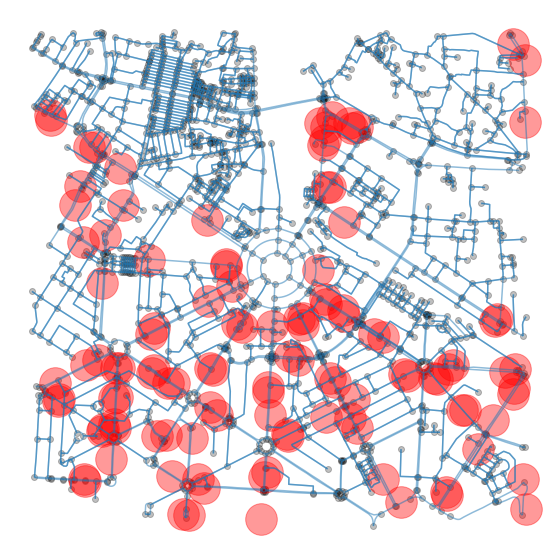

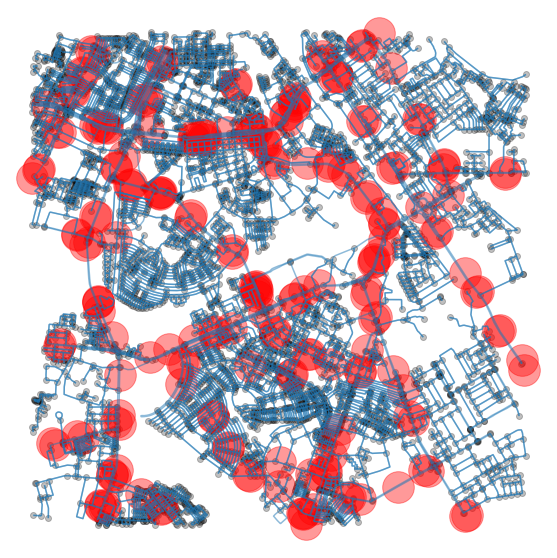

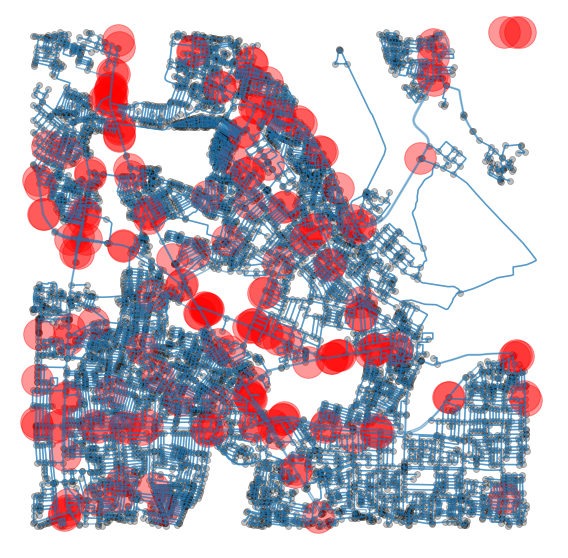

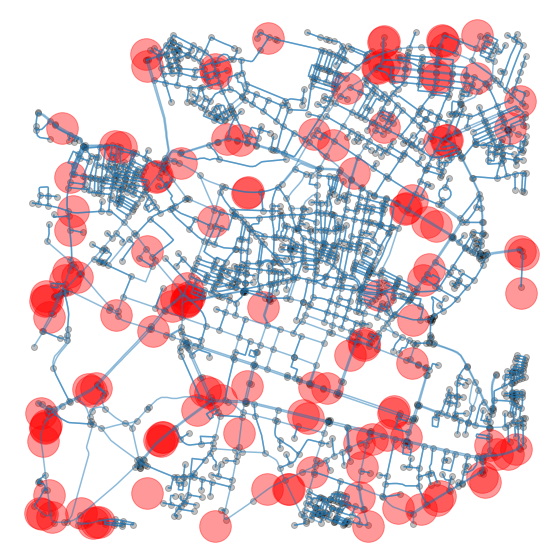

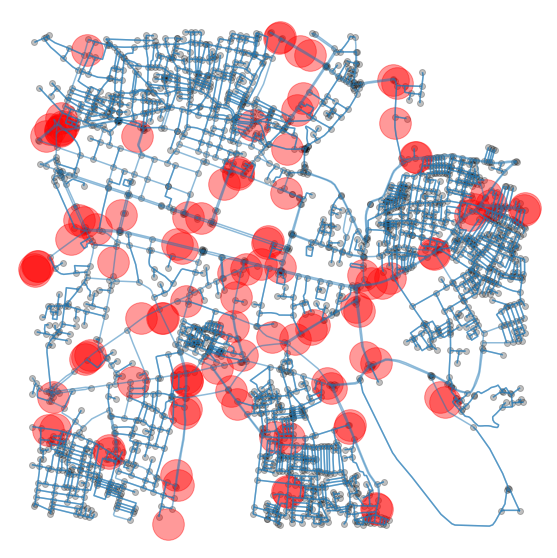

...

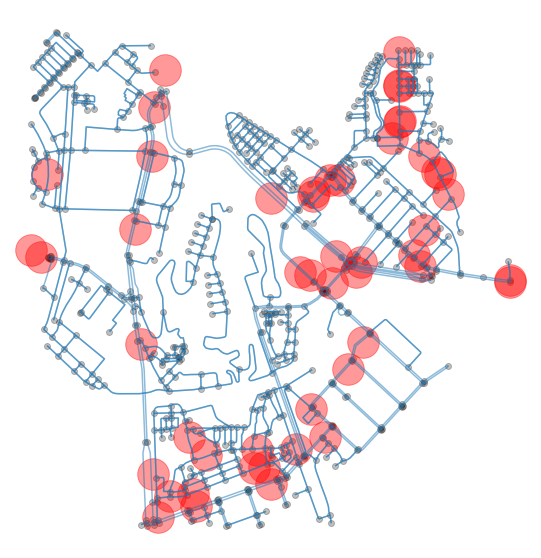

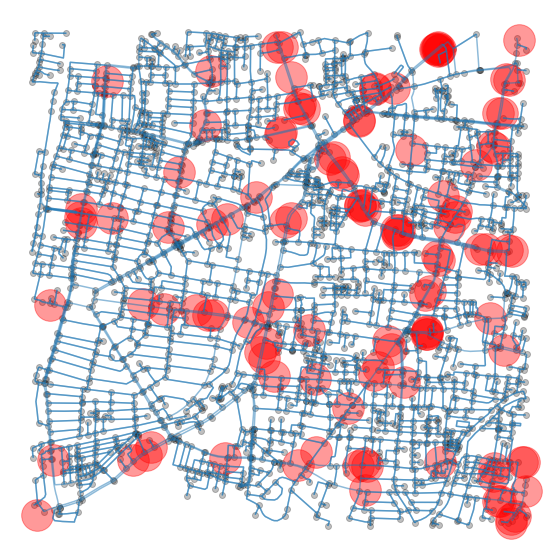

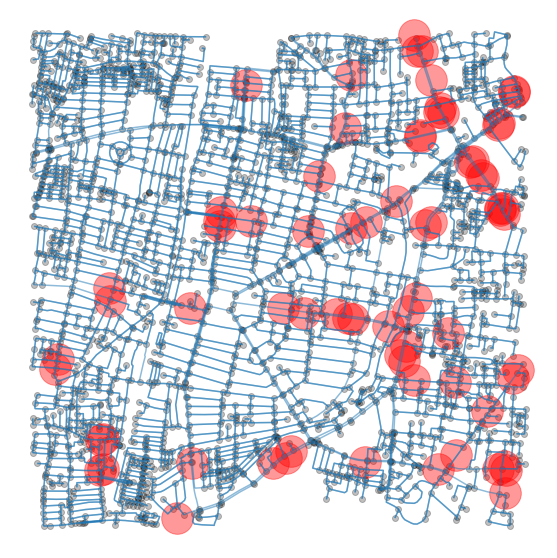

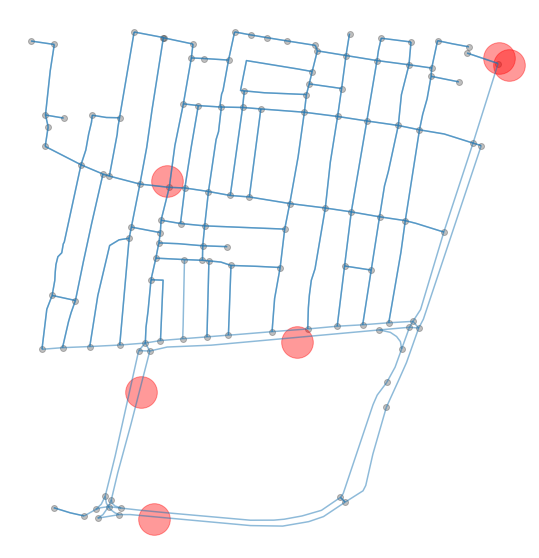

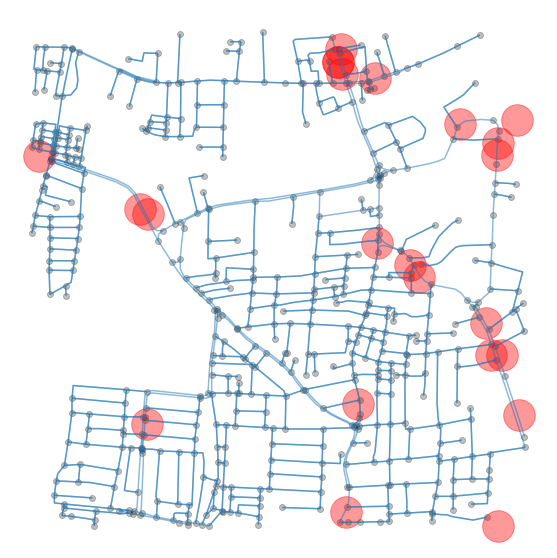

ValueError: cannot convert float NaN to integer

In [7]:
tag = {"highway": "bus_stop"}
for i, coords in cbd.cordinates.iteritems():
    
    location = tuple(map(float, coords[1:-1].split(', ')))
    dist = cbd['distance'][i]
    region = cbd['city'][i]
    place = cbd['CBD'][i]
    filepath = f"C:/Users/HP/Desktop/OSMnX Work/CBD Thesis work/{region}/{place}"
    
    # Importing data from place using centre point as drivable network
    G = ox.graph_from_point(location, dist = dist, network_type = 'drive')
    
    # Extracting nodes and edges
    nodes, edges = ox.graph_to_gdfs(G)
    
    busstop = ox.geometries_from_point(location, tag, dist=dist)
    
    # Plotting nodes and edges on axes
    ex = edges.plot(figsize=(10,10),alpha=0.5)
    ex = nodes.plot(ax=ex, color = 'black',alpha=0.25)
    ex = busstop.plot(ax = ex,color = 'red',markersize=1000, alpha = 0.4)
    ex.axis("off")
    print(f"{region},{place}: No. of Busstops = {len(busstop)}")
    
    # Saving to local disk
    fig = ex.get_figure()
    fig.savefig(f"{filepath}/Busstop_{place}.jpg")